# Based on 50 traders price change thresholded w/ cash/value variable and table
Use similar clustering and video creation

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from library import utils, config
from library.utils import cosineSimP, cosineSimP_cash
import pickle

In [2]:
Ttransactions = pd.read_csv("./results/50_traders_change_price/w_valuetable/Ttransactions_50p_100s_wvtpricechange_thresholded.csv")
TstockChars = pd.read_csv("./results/50_traders_change_price/w_valuetable/TstockCharacteristics_wvtpricechange_thresholded.csv")
TstockPool = np.loadtxt("./results/50_traders_change_price/w_valuetable/TstockPool_100s_wvtpricechange_thresholded.txt")
ThurstPool = np.loadtxt("./results/50_traders_change_price/w_valuetable/ThurstPool_100s_wvtpricechange_thresholded.txt")
with open('./results/50_traders_change_price/w_valuetable/' + 'traderIDs_50_vt_pricechange_thresholded' + '.pkl', 'rb') as f:
    traderIDswvt = pickle.load(f)



In [151]:
def cosineSimP_cash2(time, portf1, portf2): #change from .stocks array to the weightdata arrays from objects
    """
    takes two portfolio objects and finds overlap between them including cash assets

    """
    overlapWeights = 0
    ptime1 = portf1.weightdata[portf1.weightdata['time']==time]
    ptime2 = portf2.weightdata[portf2.weightdata['time']==time]
    pcash1 = portf1.valuedata[portf1.valuedata['time']==time].cash[0]
    pcash2 = portf2.valuedata[portf2.valuedata['time']==time].cash[0]
#     print(portf1.valuedata[portf1.valuedata['time']==time])
#     print(pcash1)
    for i in portf1.stocks:
        if i in portf2.weights: # find the weights in portf1 and portf2
            pweight1 = int(ptime1[ptime1['stock']==i].weight)
            pweight2 = int(ptime2[ptime2['stock']==i].weight)
            overlapWeights += (pweight1 * pweight2) # actual weight calculation
    overlapWeights += pcash1*pcash2
    
    portf1weights = np.append(ptime1.weight.values,pcash1)
    portf2weights = np.append(ptime2.weight.values,pcash2)
#     print(ptime1)
#     print(portf1weights)
    
    portf1Norm = np.linalg.norm(portf1weights)
    portf2Norm = np.linalg.norm(portf2weights)
#     print(overlapWeights)
#     print(portf1Norm, portf2Norm, portf1Norm*portf2Norm)
    if portf1.portfID == portf2.portfID:
        assert round(overlapWeights/(portf1Norm*portf2Norm)) == 1
    
    return overlapWeights/(portf1Norm*portf2Norm)

In [7]:
#no cash
mat = np.zeros((50,50))
cosins = {}
for t in range(992,2200):
    mat2 = np.zeros((50,50))
    x = 0
    y = 0
    for i, portf1 in traderIDswvt.items():
        y=0
        for j, portf2 in traderIDswvt.items():
            csmp = cosineSimP(t,portf1,portf2)
            mat2[x,y] = csmp
            y += 1
        x += 1
    mat = np.dstack((mat,mat2))
    cosins[str(t)] = np.mean(mat2)
    print(np.mean(mat2))
    print(t)
    
# mat = mat[:,:,1:]
# print(np.shape(mat))

0.13549458797741545
992
0.13538838755145402
993
0.13551555786423006
994
0.1348766829235825
995
0.13465518715895422
996
0.1346955228161396
997
0.1345324907620717
998
0.13445815204712902
999
0.13452565806651337
1000
0.13475348834380374
1001
0.13449895430144798
1002
0.1344667413118628
1003
0.13417155357673488
1004
0.13368059761492898
1005
0.13355546332571466
1006
0.13402628545806475
1007
0.13401100791180606
1008
0.13424037155681534
1009
0.13397698766616206
1010
0.1340138785704119
1011
0.13426878676918022
1012
0.1337015778884983
1013
0.13376309606987774
1014
0.1334278858921135
1015
0.1336272350171483
1016
0.13358218075083356
1017
0.1333858846925833
1018
0.13325708210874165
1019
0.13310041711825313
1020
0.13320408383473373
1021
0.13319408317838982
1022
0.133310738148013
1023
0.13294654390239322
1024
0.1332275847093024
1025
0.13337829219386246
1026
0.13343252591509905
1027
0.1335286414525009
1028
0.1336281600006909
1029
0.13373760331509849
1030
0.1336355104080235
1031
0.13375572245929848
103

0.123687759976815
1325
0.12389715161831145
1326
0.12382325700320908
1327
0.12410893653120646
1328
0.12333079993095442
1329
0.12301745553488225
1330
0.12296740088780368
1331
0.12261742358960395
1332
0.12270054183509833
1333
0.12247618655229382
1334
0.12229569467322231
1335
0.12214094764561635
1336
0.12232635301496748
1337
0.12235181811681081
1338
0.12209300517812628
1339
0.12201893206570076
1340
0.12217152423232383
1341
0.12220299194442306
1342
0.1219754112814176
1343
0.12225632278867266
1344
0.12195968381850471
1345
0.12163029016031916
1346
0.12194744289486109
1347
0.12182721503697826
1348
0.12187334483291137
1349
0.12217755094380993
1350
0.12237232681935645
1351
0.12283064997967115
1352
0.12306887034143552
1353
0.12283826174361424
1354
0.12325394340933217
1355
0.12349055928555783
1356
0.12374736784776101
1357
0.12379574395900149
1358
0.12386661194815579
1359
0.12379568897433949
1360
0.12348048740037688
1361
0.1236607280777026
1362
0.12328030515920571
1363
0.12309832839653427
1364
0.12

0.12244942404552057
1656
0.1224771538115818
1657
0.12244634512969592
1658
0.12230464648797437
1659
0.12211370325892108
1660
0.12180906464180903
1661
0.1218691546010963
1662
0.12182569871358365
1663
0.12146550710046979
1664
0.1215390614679761
1665
0.12155680988213707
1666
0.12171433032204837
1667
0.1213999938406667
1668
0.12085466706355665
1669
0.12058696837206405
1670
0.12051653586621969
1671
0.12058067904705717
1672
0.12032202721966066
1673
0.1202525527646782
1674
0.12028981793058692
1675
0.1201476550449559
1676
0.11992916054408345
1677
0.11996896944599876
1678
0.11965924256715389
1679
0.11958294524629666
1680
0.11967718733172837
1681
0.119858598007807
1682
0.11971511882139443
1683
0.11965287663838506
1684
0.11989047823591291
1685
0.1200057934545109
1686
0.12006551865828052
1687
0.11960990564861076
1688
0.12053631878975252
1689
0.12070071530927234
1690
0.12073525725629129
1691
0.12052937073389844
1692
0.12050526760827163
1693
0.11976095488800863
1694
0.11993965821493427
1695
0.1197536

0.11030733533327639
1987
0.11031918292715054
1988
0.11004969293169202
1989
0.1103191615445204
1990
0.11027089001692857
1991
0.1102530742219376
1992
0.10987114097350174
1993
0.10978837712106607
1994
0.10965290273001042
1995
0.10931828237721561
1996
0.10964796779134435
1997
0.10952798468324347
1998
0.1095298643876172
1999
0.10921053160799266
2000
0.11012943793019081
2001
0.10985702519840974
2002
0.10995211114255067
2003
0.10972274600979535
2004
0.11037675716607441
2005
0.11017887324868471
2006
0.11031833587273127
2007
0.11016428591382596
2008
0.11015132469770615
2009
0.11001847275244436
2010
0.10991791406522557
2011
0.10989190069047187
2012
0.1103892190136929
2013
0.11064645537458637
2014
0.11055216739941275
2015
0.11060159179865725
2016
0.11036994772708394
2017
0.11015878361677517
2018
0.11212800098531198
2019
0.11216148156355649
2020
0.11602096050181801
2021
0.11610311718516318
2022
0.11643849164238189
2023
0.11636506740801647
2024
0.1166144208694619
2025
0.11679023216259975
2026
0.116

TypeError: cannot convert the series to <class 'int'>

In [11]:
mat = mat[:,:,1:]
print(np.shape(mat))

(50, 50, 1207)


# Clustering

In [12]:
import hdbscan

clusterer = hdbscan.HDBSCAN()

clusterer.fit(mat[:,:,0])


HDBSCAN()

In [13]:
sortIndices = np.argsort(clusterer.labels_)
print(sortIndices)
# print(np.take_along_axis(clusterer.labels_,sortIndices, axis =0))

[24 43 42 40 39  5 36 27 23  9 11 14 15 22 21 20  0 49  2  1  6 41 32 31
 30 29 28  7 44 45 48  8 10 46 47 19 18  3  4 17 37 35 34 16 26 25 12 13
 38 33]


In [14]:
# cosins

/home/braedyn/anaconda3/envs/mat36/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  


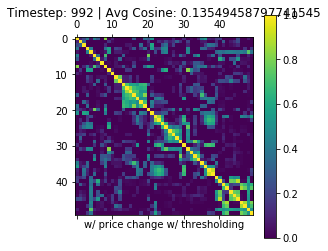

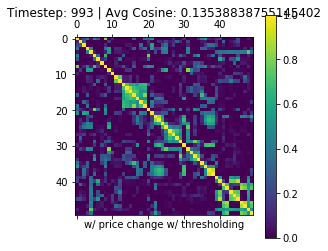

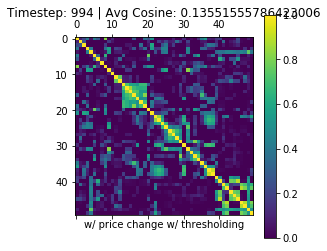

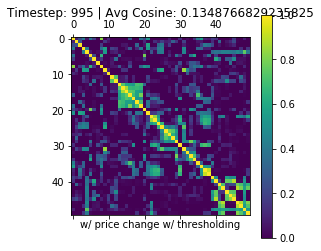

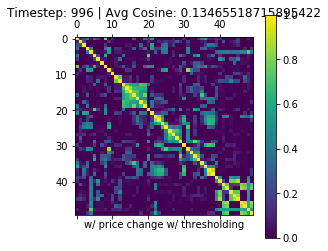

...

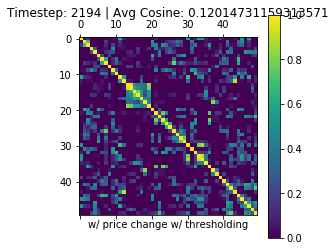

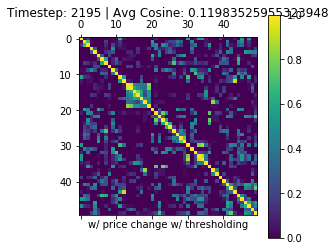

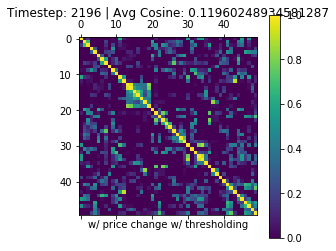

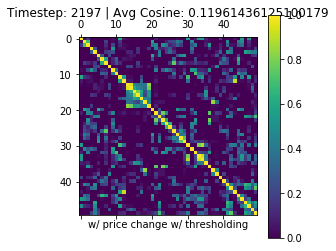

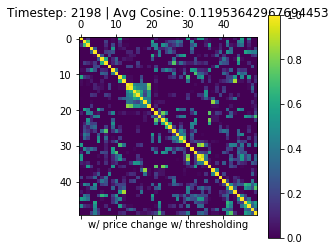

In [15]:
for i,t in enumerate(range(992,2199)):
    plt.matshow(mat[[sortIndices]][:,sortIndices,i]) # from HDBSCAN np.argsort or use np.ix_ 
    plt.title("Timestep: "+ str(t)+" | Avg Cosine: "+str(cosins[str(t)]), y=1.08)
    plt.xlabel("w/ price change w/ thresholding")
    plt.colorbar()
    plt.savefig('./results/50_traders_change_price/w_valuetable/'+str(t).zfill(6)+'nocash_tmp.png', dpi=300)
    plt.show()

In [16]:
# mencoder 'mf://*nocash_tmp.png' -mf type=png:fps=4 -ovc lavc -lavcopts vcodec=wmv2 -oac copy -o ./results/50_traders_change_price/w_valuetable/cosinesim_nocash_50_pricechange_thresholding.mpg
with open('./results/50_traders_change_price/w_valuetable/'+ 'cosinesims_50_pricechange_thresholded' + '.pkl', 'wb') as f:
    pickle.dump(cosins, f, pickle.HIGHEST_PROTOCOL)

# Looking at transactions list

In [2]:
# Ttransactions = pd.read_csv("./results/50_traders_change_price/Ttransactions_50p_100s_pricechange_thresholded.csv")
# TstockChars = pd.read_csv("./results/50_traders_change_price/TstockCharacteristics_pricechange_thresholded.csv")
# TstockPool = pd.read_csv("./results/50_traders_change_price/TstockPool_100s_pricechange_thresholded.txt")
# ThurstPool = pd.read_csv("./results/50_traders_change_price/ThurstPool_100s_pricechange_thresholded.txt")

In [10]:
totalCascades = np.asarray([])
for s in range(100):
    stockTrans = Ttransactions[Ttransactions['stock']==s]
    if len(stockTrans) > 0:
#         stockTrans.hist(column='ToS', bins=np.arange(992,2000))
#         plt.title("Transactions of stock: "+ str(s))
#         plt.show()
        cascades = findStockCascades(stockTrans, maxSep = 2)
#         print(len(cascades))
        totalCascades = np.append(totalCascades,cascades)

In [17]:
hist, bins = np.histogram(totalCascades, bins=np.logspace(np.log10(1),np.log10(3000),25))
binsize = np.diff(bins)

mid = np.array([])
for i in range(len(binsize)):
    avg = (bins[i]+bins[i+1])/2
    mid = np.append(mid,avg)

24
25
24
[1.19799138e+00 1.67237530e+00 2.33460707e+00 3.25907120e+00
 4.54960718e+00 6.35117315e+00 8.86612817e+00 1.23769620e+01
 1.72780255e+01 2.41198255e+01 3.36708604e+01 4.70039404e+01
 6.56166900e+01 9.15997675e+01 1.27871695e+02 1.78506681e+02
 2.49192248e+02 3.47868080e+02 4.85617840e+02 6.77914128e+02
 9.46356430e+02 1.32109725e+03 1.84422898e+03 2.57451184e+03]


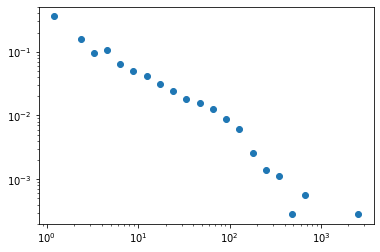

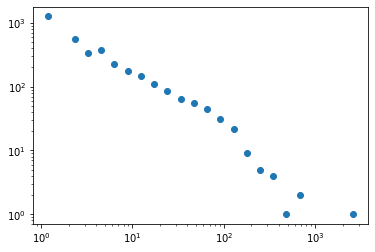

In [37]:
plt.plot(mid,hist,'o')
plt.loglog()
plt.show()

In [106]:
print(((stockTrans.ToS.unique())))
print(np.diff(stockTrans.ToS.unique()))
keys = (np.where(np.diff(stockTrans.ToS.unique())>10))

[1665 1671 1675 1688 1689 1692 1695 1701 1705 1706 1709 1711 1712 1713
 1715 1716 1723 1724 1726 1728 1729 1730 1731 1734 1738 1746 1753 1757
 1758 1760 1762 1764 1766 1768 1772 1773 1775 1776 1777 1778 1780 1781
 1782 1786 1788 1789 1792 1793 1794 1797 1799 1800 1813 1819 1824 1825
 1827 1828 1830 1832 1834 1838 1842 1844 1845 1849 1851 1855 1857 1860
 1863 1866 1869 1870 1874 1875 1876 1891 1896 1898 1901 1903 1911 1913
 1915 1926 1933 1936 1946 1956 1960 1965 1967 1972 1978 1984 1985 1986
 1997]
[ 6  4 13  1  3  3  6  4  1  3  2  1  1  2  1  7  1  2  2  1  1  1  3  4
  8  7  4  1  2  2  2  2  2  4  1  2  1  1  1  2  1  1  4  2  1  3  1  1
  3  2  1 13  6  5  1  2  1  2  2  2  4  4  2  1  4  2  4  2  3  3  3  3
  1  4  1  1 15  5  2  3  2  8  2  2 11  7  3 10 10  4  5  2  5  6  6  1
  1 11]


In [132]:
# stockTrans.ToS.unique()[np.where(np.diff(stockTrans.ToS.unique())>10)]
len([])

0

In [3]:
def findStockCascades(stockTrans, maxSep = 10):
    """
    works on transactions and stockTransactions tables
    """
    
    if len(stockTrans) > 0 :
        ToS = stockTrans.ToS.unique()
        sep = np.diff(ToS)
        keySep = np.where(sep>maxSep)[0]

        i0 = 0
        cascadeSizes = np.asarray([])
        for key in keySep:
            key += 1
    #         print(i0, key)
            times = ToS[i0:key]
            cascadeSize = len(stockTrans[stockTrans.ToS.isin(times)])
            cascadeSizes = np.append(cascadeSizes,cascadeSize)
            i0 = key

        return cascadeSizes
    else:
        return []

In [116]:
findStockCascades(stockTrans)

0 3
3 52
52 77
77 85
85 98


array([ 3., 49., 26.,  8., 13.])

In [120]:
print(stockTrans.ToS.unique())
print(stockTrans.ToS.unique()[0:3])
print(stockTrans.ToS.unique()[3:52])
print(stockTrans.ToS.unique()[52:77])
print(stockTrans.ToS.unique()[77:85])
print(stockTrans.ToS.unique()[85:98])

[1665 1671 1675 1688 1689 1692 1695 1701 1705 1706 1709 1711 1712 1713
 1715 1716 1723 1724 1726 1728 1729 1730 1731 1734 1738 1746 1753 1757
 1758 1760 1762 1764 1766 1768 1772 1773 1775 1776 1777 1778 1780 1781
 1782 1786 1788 1789 1792 1793 1794 1797 1799 1800 1813 1819 1824 1825
 1827 1828 1830 1832 1834 1838 1842 1844 1845 1849 1851 1855 1857 1860
 1863 1866 1869 1870 1874 1875 1876 1891 1896 1898 1901 1903 1911 1913
 1915 1926 1933 1936 1946 1956 1960 1965 1967 1972 1978 1984 1985 1986
 1997]
[1665 1671 1675]
[1688 1689 1692 1695 1701 1705 1706 1709 1711 1712 1713 1715 1716 1723
 1724 1726 1728 1729 1730 1731 1734 1738 1746 1753 1757 1758 1760 1762
 1764 1766 1768 1772 1773 1775 1776 1777 1778 1780 1781 1782 1786 1788
 1789 1792 1793 1794 1797 1799 1800]
[1813 1819 1824 1825 1827 1828 1830 1832 1834 1838 1842 1844 1845 1849
 1851 1855 1857 1860 1863 1866 1869 1870 1874 1875 1876]
[1891 1896 1898 1901 1903 1911 1913 1915]
[1926 1933 1936 1946 1956 1960 1965 1967 1972 1978 1984 198

# Var vs alloc

In [130]:
# for i, portf in traderIDswvt.items():
# #     print(len(portf.valuedata.time.unique()))
# #     print(len(portf.weightdata.time.unique()))  
#     print(portf.portfID)
# #     plt.plot(portf.valuedata.time.values,portf.valuedata.value.values)
# #     plt.show()

# portf = traderIDswvt['okcps']


In [131]:
# print(TstockChars)
# print(portf.valuedata[portf.valuedata.time==992].value[0])
# print(portf.weightdata)

       ID  time  stock  weight
0   okcps   991     60     0.0
0   okcps   991     10    70.0
0   okcps   991     51     0.0
0   okcps   991     97    38.0
0   okcps   991     90     0.0
..    ...   ...    ...     ...
0   okcps  2198     98    21.0
0   okcps  2198     70     0.0
0   okcps  2198     46     0.0
0   okcps  2198     81     6.0
0   okcps  2198     63     0.0

[18120 rows x 4 columns]


In [6]:
def weightvarMovie(portf,TstockChars,TstockPool):
    ovar = np.array([])
    oalloc = np.array([])
    ocashalloc = 0
    times = portf.valuedata.time.unique()
    
    for t in times[1::10]:
        alloc = np.array([])
        var = np.array([])
        stocks = portf.stocks
        maxvar = max(TstockChars[TstockChars.stock.isin(stocks)]['var'])+0.5
        maxalloc = 1
        
        
        for s in stocks:
            weight = portf.weightdata[portf.weightdata.time==t]
            alloc = np.append(alloc, weight[weight.stock==s].weight[0]*TstockPool[s,t]/
                                 portf.valuedata[portf.valuedata.time==t].value[0])
            timeStockChars = TstockChars[TstockChars.time==t]
            var = np.append(var,timeStockChars[timeStockChars.stock==s]['var'])
            
        # include cash
        cashalloc = portf.valuedata[portf.valuedata.time==t].cash[0]/portf.valuedata[portf.valuedata.time==t].value[0]
        cashvar = 0
        
        plt.plot(cashvar, ocashalloc, 'o', color='lightgreen')
        plt.plot(cashvar, cashalloc, 'o', color='green', label='Cash')
        plt.plot(ovar,oalloc,'o', color = 'lightblue')
        plt.plot(var,alloc, 'o')
        plt.grid(True)
    #     plt.xlim(right=maxvar, left=0)
    #     plt.ylim(top=maxalloc,bottom=0)
        plt.xlabel("Stock Variance")
        plt.ylabel("Weight Allocation")
        plt.legend()
        plt.title("Portf ID: " + str(portf.portfID) +" | Time: "+ str(t))
        plt.savefig("./results/50_traders_change_price/w_valuetable/"+str(t).zfill(6)+'wv_tmp.png',dpi=250)
        plt.close()
        ovar = var
        oalloc = alloc 
        ocashalloc = cashalloc
    print("Done")
    print("mencoder 'mf://*wv_tmp.png' -mf type=png:fps=4 -ovc lavc -lavcopts vcodec=wmv2 -oac copy -o ./weightvar_"+portf.portfID+"_pricechange_thresholding.mpg")
        
weightvarMovie(traderIDswvt['puokv'],TstockChars,TstockPool)

Done
mencoder 'mf://*wv_tmp.png' -mf type=png:fps=4 -ovc lavc -lavcopts vcodec=wmv2 -oac copy -o ./weightvar_puokv_pricechange_thresholding.mpg


In [120]:
# mencoder 'mf://*wv_tmp.png' -mf type=png:fps=4 -ovc lavc -lavcopts vcodec=wmv2 -oac copy -o ./weightvar_puokv_pricechange_thresholding.mpg

4.29818110778916

In [128]:
import subprocess